In [1]:
import os
import sys
import cv2
import tifffile
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors
from skimage.measure import label
from skimage.util import invert
from skimage.morphology import dilation, square


sys.path.insert(0, os.path.abspath(os.path.join(os.getcwd(), "..")))
from src.lib import cell_blobs_skimage as blobsutils
from src.lib import utils

In [2]:
imgs_dir = '../data/raw/all/'
save_dir_imgs = '../data/interim/all/images/blobs_broken'
save_dir_dfs = '../data/interim/all/dataframes/blobs_broken'
os.makedirs(save_dir_dfs, exist_ok=True)
os.makedirs(save_dir_imgs, exist_ok=True)

In [3]:
# dfs = {}
# 
# for index, name_ext in enumerate(os.listdir(os.path.join(imgs_dir, 'Broken'))):
#     name, ext = os.path.splitext(name_ext)
#     if ext != '.tif':
#         continue
#     img_name = name[:-1]
#     broken_img = utils.load_broken(imgs_dir, img_name)
#     df, blobs_img_dil = blobsutils.get_blobs_measurements(broken_img, return_img=True, do_dilation=True)
#     blobs_img_dil = blobs_img_dil.astype(np.uint16)
#     df['relative_area'] = df['area'] / (broken_img.shape[0] * broken_img.shape[1])
#     df.to_csv(os.path.join(save_dir_dfs, f'{img_name}.csv'))
#     tifffile.imsave(os.path.join(save_dir_imgs, f'{img_name}.tif'), blobs_img_dil)
#     dfs[img_name] = df
#     print(index, img_name, len(np.unique(blobs_img_dil)))

In [4]:
dfs = {}

for index, name_ext in enumerate(os.listdir(os.path.join(imgs_dir, 'Broken'))):
    name, ext = os.path.splitext(name_ext)
    if ext != '.tif':
        continue
    img_name = name[:-1]
    dfs[img_name] = pd.read_csv(os.path.join(save_dir_dfs, f'{img_name}.csv'))
    print(index, img_name, len(dfs[img_name]))

0 ILK_F1_NS 122
1 AJAP1_A2_NO 374
2 CDC42_A3_NO 126
3 AJAP1_A3_NO 106
4 MET_E1_NS 190
5 ACTN1_B2_NS 176
6 TUBA1B_I2_NO 76
7 PVRL1_I3_NO 328
8 SDC1_I2_NO 78
9 ENAH_B1_NO 63
10 RAPGEF2_G2_NS 86
11 TRIP6_H2_NS 187
12 ABI2_A1_NO 28
13 LIMA1_F2_NS 605
14 VEZT_G3_NS 140
15 RDX_H2_NO 52
16 PIK3CA_D1_NO 25
17 MET_E1_NO 96
18 SRGAP3_I1_NO 158
19 LMO7_F3_NO 93
20 PTPRJ_G1_NO 49
21 RDX_H1_NO 67
22 EPB4.1_B2_NO 156
23 BCAR1_B2_NS 300
24 ARHGAP4_A1b_NS 741
25 CDH1_B2_NS 323
26 PVRL1_I2_NS 172
27 CCNG1_L1_NO 241
28 GNB2L1_E3_NS 395
29 DYNC1H1_A1_NO 22
30 DNMBP_A3_NS 172
31 ENAH_B2_NS 190
32 DLG5_A3_NS 272
33 CDC42_A2_NO 70
34 ARHGEF2_A3_NO 203
35 EPB4.1_B3_NO 36
36 MYH9_F2_NO 52
37 ACTN1_B1_NS 55
38 ABI1_A2_NO 135
39 PTPRJ_G2_NO 96
40 TMOD3_I2_NS 146
41 ABL1_A3_NS 119
42 ARVCF_A1_NO 22
43 SRGAP2_I2_NO 101
44 CTNNA3_L2_NO 38
45 PLEKHA7_E2_NO 302
46 ROCK1_H1_NS 152
47 VEZT_G2_NS 144
48 GRLF1_C3_NS 254
49 RHOA_H1_NS 81
50 ITGA3_F3_NS 71
51 P2RX4_E1_NO 59
52 CTNNA2_L2_NS 125
53 ERBB2IP_C3c_NO 58
54 FBLI

In [5]:
dfs_ordered = dict(sorted(dfs.items(), key=lambda item: item[1]['relative_area'].sum(), reverse=True))

In [6]:
key_max, df_max = max(dfs.items(), key=lambda item: len(item[1]))
n_max = len(df_max)
cmap = colors.ListedColormap(['black'] + [f'#{c:06x}' for c in np.random.randint(1000, 0x1000000, n_max - 1)])
norm = colors.BoundaryNorm(range(n_max + 1), cmap.N, clip=False)

In [7]:
len(dfs) / 3

112.66666666666667

In [8]:
n = 113
fig, ax = plt.subplots(n, 6, figsize=(5*6, 5*n))
subdict = dict(itertools.islice(dfs_ordered.items(), n*3))
for index, (img_name, df) in enumerate(subdict.items()):
    i, j = index // 3, index % 3
    blobs_img = tifffile.imread(os.path.join(save_dir_imgs, f'{img_name}.tif'))
    blobs_img = cv2.resize(blobs_img, (300, 300))
    blobs_img[blobs_img != 0] = 255
    area_broken = df['relative_area'].sum() * 100
    ax[i, 2*j].imshow(blobs_img, cmap='cividis')
    ax[i, 2*j].set_xticks([])
    ax[i, 2*j].set_yticks([])
    ax[i, 2*j].set_xlabel(f'{img_name}\n({area_broken:.2f}% broken, {len(df)} blobs)')
    _, bins, _ = ax[i, 2*j + 1].hist(100*df['relative_area'], bins='doane')
    ax[i, 2*j + 1].set_xticks(bins)
    ax[i, 2*j + 1].set_xticklabels([f'{n:.1f}' for n in bins], rotation=90)
    print(img_name)

fig.savefig('histograms_broken.png')

VASP_I1_NO
TRPV4_L3_NO
VEZT_G3_NO
CDC42_A1_NO
Sipa1L3_L2_NO
TRPC4_I1_NO
RAC1_I1_NO
ACTN4_L2_NO
VEZT_G3_NS
TRPV4_L2_NO
ARHGAP12_L2_NO
GNA12_E2_NS
SDCBP_I2_NS
SDCBP_I1_NO
TMOD3_I1_NO
CDH1_B3_NO
CDH1_B2_NO
SDCBP_I2_NO
CTNNA2_L2_NS
ROCK1_H2_NO
CTNNA3_L2_NO
CTNNA2_L2_NO
RAC1_I2_NO
RAC1_I2_NS
PTPRT_H2_NO
EGFR_B1_NO
LMO7_F2_NO
CDH1_B2_NS
ACTN4_L2_NS
ARHGAP12_L2_NS
CDH1_B3_NS
WASF2_H2_NO
CCNG1_L2_NO
SDC1_I2_NO
CTNNB1_A1_NO
PTPRT_H2_NS
TRPV4_L2_NS
TRIO_H2_NO
ARHGEF12_L2_NO
ARVCF_A3_NO
CDH1_B1_NO
TMOD1_I1_NO
TRIOBP_H2_NO
GRLF1_L2_NS
ITGA3_F3_NO
ARHGEF2_A3_NO
PVRL1_I2_NO
CTNNA1_A1_NS
ITGA3_F3_NS
LMO7_F3_NO
CD151_A3_NO
TMOD3_I2_NO
ABI2_A3_NO
DLG5_A3_NO
ROCK1_H2_NS
MET_E1_NO
SRGAP3_I2_NO
RDX_H1_NO
VASP_I2_NS
CAMSAP3-2310057J16RIK_E1_NO
ITGA3_F2_NO
ADD1_A1b_NO
WASL_H2_NO
TRIP6_H2_NS
PVRL1_I2_NS
ABI1_A3_NS
PTPRJ_G1_NO
TRIP6_H2_NO
AJAP1_A3_NO
VEZT_G2_NS
CBLL1_A1_NO
ARHGEF2_A1b_NO
PTPRM_H1_NO
ERBB2IP_C3c_NO
ITGA3_F2_NS
CTNNA1_A1_NO
ARHGAP4_A3_NS
PTK2B_E1_NO
GRLF1_L2_NO
DLG5_A3_NS
PTPRF_G2_NS
CSNK1E_A1b

In [9]:
n = 113
fig, ax = plt.subplots(n, 6, figsize=(5*6, 5*n))
subdict = dict(itertools.islice(dfs_ordered.items(), n*3))
for index, (img_name, df) in enumerate(subdict.items()):
    i, j = index // 3, index % 3
    blobs_img = tifffile.imread(os.path.join(save_dir_imgs, f'{img_name}.tif'))
    blobs_img = cv2.resize(blobs_img, (300, 300))
    mask_small = df['area'] < 900
    labels_small = df.loc[mask_small, 'label'].values
    blobs_img[np.isin(blobs_img, labels_small)] = 0
    blobs_img[blobs_img != 0] = 255

    df_no_small = df[~mask_small]
    area_broken = df_no_small['relative_area'].sum() * 100
    
    ax[i, 2*j].imshow(blobs_img, cmap='cividis', norm=norm)
    ax[i, 2*j].set_xticks([])
    ax[i, 2*j].set_yticks([])
    ax[i, 2*j].set_xlabel(f'{img_name}\n({area_broken:.2f}% broken, {len(df_no_small)} blobs)')
    _, bins, _ = ax[i, 2*j + 1].hist(100*df_no_small['relative_area'], bins='doane')
    ax[i, 2*j + 1].set_xticks(bins)
    ax[i, 2*j + 1].set_xticklabels([f'{n:.1f}' for n in bins], rotation=90)
    print(img_name)

fig.savefig('histograms_broken_no_small.png')

VASP_I1_NO
TRPV4_L3_NO
VEZT_G3_NO
CDC42_A1_NO
Sipa1L3_L2_NO
TRPC4_I1_NO
RAC1_I1_NO
ACTN4_L2_NO
VEZT_G3_NS
TRPV4_L2_NO
ARHGAP12_L2_NO
GNA12_E2_NS
SDCBP_I2_NS
SDCBP_I1_NO
TMOD3_I1_NO
CDH1_B3_NO
CDH1_B2_NO
SDCBP_I2_NO
CTNNA2_L2_NS
ROCK1_H2_NO
CTNNA3_L2_NO
CTNNA2_L2_NO
RAC1_I2_NO
RAC1_I2_NS
PTPRT_H2_NO
EGFR_B1_NO
LMO7_F2_NO
CDH1_B2_NS
ACTN4_L2_NS
ARHGAP12_L2_NS
CDH1_B3_NS
WASF2_H2_NO
CCNG1_L2_NO
SDC1_I2_NO
CTNNB1_A1_NO
PTPRT_H2_NS
TRPV4_L2_NS
TRIO_H2_NO
ARHGEF12_L2_NO
ARVCF_A3_NO
CDH1_B1_NO
TMOD1_I1_NO
TRIOBP_H2_NO
GRLF1_L2_NS
ITGA3_F3_NO
ARHGEF2_A3_NO
PVRL1_I2_NO
CTNNA1_A1_NS
ITGA3_F3_NS
LMO7_F3_NO
CD151_A3_NO
TMOD3_I2_NO
ABI2_A3_NO
DLG5_A3_NO
ROCK1_H2_NS
MET_E1_NO
SRGAP3_I2_NO
RDX_H1_NO
VASP_I2_NS
CAMSAP3-2310057J16RIK_E1_NO
ITGA3_F2_NO
ADD1_A1b_NO
WASL_H2_NO
TRIP6_H2_NS
PVRL1_I2_NS
ABI1_A3_NS
PTPRJ_G1_NO
TRIP6_H2_NO
AJAP1_A3_NO
VEZT_G2_NS
CBLL1_A1_NO
ARHGEF2_A1b_NO
PTPRM_H1_NO
ERBB2IP_C3c_NO
ITGA3_F2_NS
CTNNA1_A1_NO
ARHGAP4_A3_NS
PTK2B_E1_NO
GRLF1_L2_NO
DLG5_A3_NS
PTPRF_G2_NS
CSNK1E_A1b

In [13]:
relative_areas = [df['relative_area'] for name, df in dfs.items()]

In [18]:
relative_areas_all = np.concatenate(relative_areas)

(array([4.8922e+04, 1.1400e+02, 4.3000e+01, 2.1000e+01, 8.0000e+00,
        1.0000e+01, 7.0000e+00, 4.0000e+00, 3.0000e+00, 1.0000e+01,
        2.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00, 2.0000e+00,
        0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00, 0.0000e+00,
        2.0000e+00, 0.0000e+00, 1.0000e+00, 0.0000e+00, 1.0000e+00,
        0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 0.0000e+00, 2.0000e+00, 2.0000e+00,
        0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00, 0.0000e+00,
        1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.00

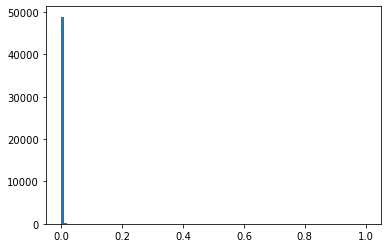

In [24]:
plt.hist(relative_areas_all, bins=np.linspace(0, 1, 101))

In [23]:
np.linspace(0, 1, 101)

array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
       0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
       0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32,
       0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43,
       0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54,
       0.55, 0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64, 0.65,
       0.66, 0.67, 0.68, 0.69, 0.7 , 0.71, 0.72, 0.73, 0.74, 0.75, 0.76,
       0.77, 0.78, 0.79, 0.8 , 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87,
       0.88, 0.89, 0.9 , 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98,
       0.99, 1.  ])

In [29]:
relative_areas_no_small = [df.loc[df['area'] > 900, 'relative_area'] for name, df in dfs.items()]
relative_areas_no_small = np.concatenate(relative_areas_no_small)

In [30]:
len(relative_areas_no_small)

2963

(array([2.713e+03, 1.140e+02, 4.300e+01, 2.100e+01, 8.000e+00, 1.000e+01,
        7.000e+00, 4.000e+00, 3.000e+00, 1.000e+01, 2.000e+00, 0.000e+00,
        0.000e+00, 2.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 2.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

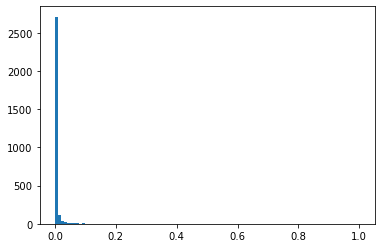

In [31]:
plt.hist(relative_areas_no_small, bins=np.linspace(0, 1, 101))